fine-tuning a pretrained object detection model

following tutorial: [fine-tuning pre-triained models](https://docs.pytorch.org/tutorials/intermediate/torchvision_tutorial.html)

train dataset is [1,2,3,4,5,6,7] android images
test dataset is video snapshots of android statues

In [1]:
import load_statues
import load_pytorch_models
import os
import sys
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
import torch
from torch.utils.data import Dataset
from torchvision import tv_tensors
from torchvision.tv_tensors import BoundingBoxFormat
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
from torchvision.io import read_image
from torchvision.ops.boxes import masks_to_boxes
from torchvision.transforms.v2 import functional as F


#add 1 to number of classes to preserve class 0, but constraints of the pretrained model
num_classes_custom = len(load_statues.class_mapping)  + 1 #9
print(f'num_classes_custom={num_classes_custom}')

num_classes_custom=10


In [2]:
model = load_pytorch_models.get_faster_rcnn(num_classes_custom)

in_features=1024


In [3]:
#model2 = load_pytorch_models.get_faster_rcnn_with_masks(num_classes_custom)

In [4]:
#putting these in bin... change as needed
module_dir = os.path.join(os.getcwd(), '..', 'bin')
sys.path.append(module_dir)
if not os.path.exists(os.path.join(module_dir, "utils.py")):
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py" -o ../bin/engine.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py" -o ../bin/utils.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py" -o ../bin/coco_utils.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py" -o ../bin/coco_eval.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py" -o ../bin/transforms.py

import utils

category_index, dataset, dataset_test = load_statues.load_statues(\
    load_pytorch_models.get_transform(train=True))

print(f'load data')
data_loader = torch.utils.data.DataLoader(dataset,\
    batch_size=1,
    shuffle=False,
    collate_fn=utils.collate_fn)

if True:
    print(f'check inputs accepted by model')
    _images, _targets = next(iter(data_loader))
    _images = list(image for image in _images)
    _targets = [{k: v for k, v in t.items()} for t in _targets]
    output = model(_images, _targets)  # Returns losses and detections
    print(output)

from engine import train_one_epoch, evaluate

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)


load data
check inputs accepted by model
{'loss_classifier': tensor(2.0245, grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.8349, grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.1015), 'loss_rpn_box_reg': tensor(0.0034)}


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

install the video software and sample some frames from the video

In [5]:
#editing for video
filepaths = load_statues.get_video_snapshot_filepaths()


have already downloaded YouTube mp4 file


run pre-trained model on test data
labels[0]=['5: 0.232', '5: 0.225', '2: 0.211', '5: 0.207', '5: 0.207', '8: 0.205', '7: 0.198', '7: 0.198', '2: 0.196', '6: 0.194', '2: 0.193', '2: 0.191', '5: 0.190', '4: 0.188', '2: 0.188', '2: 0.187', '7: 0.186', '2: 0.185', '5: 0.184', '5: 0.181', '5: 0.181', '7: 0.181', '1: 0.179', '5: 0.179', '7: 0.178', '2: 0.176', '7: 0.175', '8: 0.175', '5: 0.174', '2: 0.173', '8: 0.172', '2: 0.171', '1: 0.171', '7: 0.171', '3: 0.170', '1: 0.170', '7: 0.170', '1: 0.170', '7: 0.169', '5: 0.169', '6: 0.169', '7: 0.169', '7: 0.168', '2: 0.167', '1: 0.167', '2: 0.167', '2: 0.167', '2: 0.166', '5: 0.166', '4: 0.166', '2: 0.166', '2: 0.165', '6: 0.165', '2: 0.165', '7: 0.165', '2: 0.164', '4: 0.164', '2: 0.164', '2: 0.164', '6: 0.164', '5: 0.164', '2: 0.164', '5: 0.163', '2: 0.163', '2: 0.163', '2: 0.163', '5: 0.163', '5: 0.162', '4: 0.162', '2: 0.162', '7: 0.162', '5: 0.162', '5: 0.161', '5: 0.161', '2: 0.161', '1: 0.161', '2: 0.161', '4: 0.161', '5: 0.160', '1: 0.

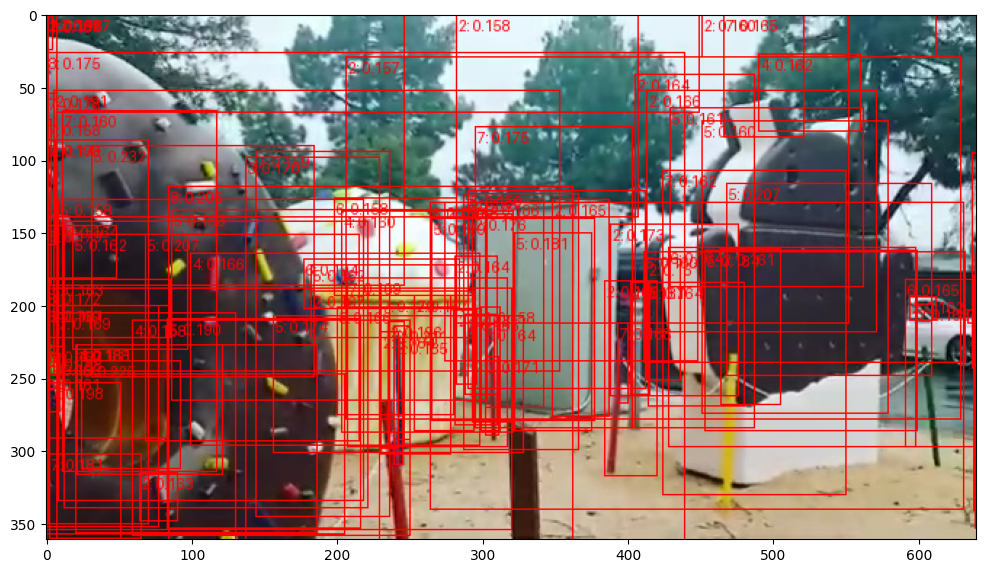

labels[1]=['7: 0.254', '7: 0.240', '6: 0.220', '7: 0.212', '5: 0.210', '5: 0.209', '6: 0.206', '2: 0.198', '7: 0.195', '6: 0.193', '2: 0.191', '5: 0.186', '2: 0.185', '7: 0.184', '5: 0.184', '7: 0.183', '7: 0.182', '1: 0.182', '8: 0.180', '2: 0.178', '7: 0.178', '5: 0.176', '3: 0.175', '5: 0.175', '2: 0.175', '2: 0.173', '1: 0.171', '2: 0.171', '2: 0.171', '5: 0.169', '6: 0.169', '5: 0.169', '5: 0.169', '7: 0.168', '5: 0.165', '2: 0.165', '8: 0.165', '8: 0.165', '7: 0.163', '6: 0.163', '5: 0.163', '2: 0.163', '5: 0.163', '6: 0.163', '6: 0.162', '1: 0.162', '5: 0.162', '2: 0.162', '2: 0.162', '2: 0.162', '8: 0.162', '5: 0.161', '1: 0.161', '5: 0.160', '2: 0.160', '5: 0.159', '5: 0.159', '5: 0.159', '5: 0.159', '2: 0.159', '1: 0.158', '6: 0.158', '2: 0.157', '5: 0.157', '5: 0.156', '1: 0.156', '1: 0.156', '2: 0.156', '1: 0.155', '5: 0.155', '5: 0.155', '7: 0.155', '5: 0.155', '3: 0.154', '2: 0.154', '7: 0.154', '2: 0.154', '7: 0.154', '2: 0.154', '3: 0.154', '2: 0.154', '5: 0.154', '7: 0

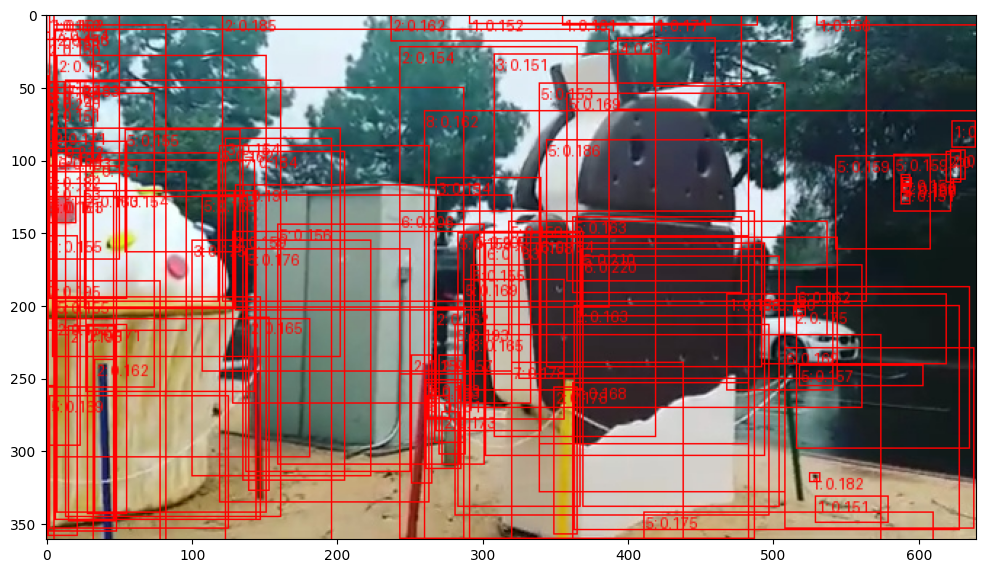

labels[2]=['7: 0.293', '2: 0.286', '2: 0.253', '2: 0.239', '2: 0.239', '7: 0.237', '7: 0.236', '7: 0.232', '7: 0.229', '2: 0.226', '2: 0.224', '2: 0.215', '4: 0.211', '7: 0.211', '2: 0.210', '2: 0.210', '2: 0.210', '7: 0.209', '2: 0.209', '2: 0.206', '5: 0.203', '2: 0.203', '7: 0.201', '4: 0.199', '2: 0.199', '1: 0.199', '2: 0.194', '2: 0.193', '2: 0.193', '2: 0.192', '7: 0.191', '7: 0.190', '2: 0.188', '2: 0.188', '2: 0.188', '4: 0.188', '2: 0.187', '7: 0.184', '7: 0.183', '2: 0.181', '5: 0.181', '2: 0.180', '2: 0.179', '2: 0.179', '2: 0.178', '2: 0.177', '8: 0.176', '5: 0.176', '4: 0.173', '1: 0.173', '5: 0.173', '1: 0.172', '2: 0.172', '8: 0.172', '2: 0.171', '7: 0.171', '2: 0.170', '2: 0.170', '1: 0.169', '7: 0.168', '2: 0.168', '2: 0.168', '5: 0.168', '2: 0.167', '7: 0.167', '1: 0.167', '7: 0.167', '2: 0.167', '4: 0.166', '5: 0.166', '5: 0.166', '1: 0.165', '2: 0.165', '2: 0.165', '7: 0.164', '2: 0.164', '2: 0.163', '2: 0.163', '5: 0.163', '7: 0.163', '7: 0.162', '2: 0.162', '5: 0

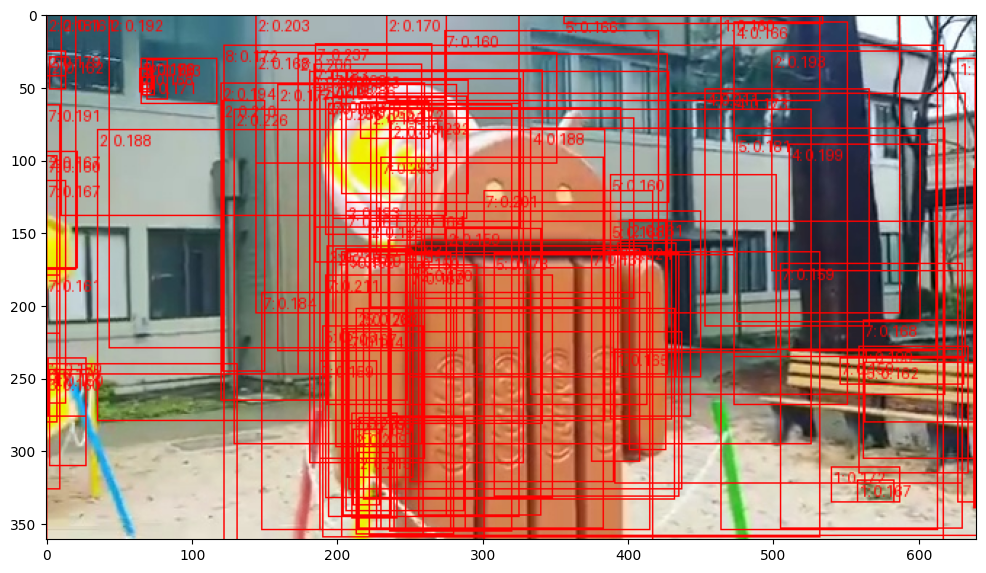

labels[3]=['7: 0.236', '7: 0.233', '2: 0.224', '7: 0.216', '4: 0.216', '7: 0.210', '7: 0.204', '2: 0.202', '7: 0.202', '5: 0.199', '2: 0.198', '6: 0.198', '2: 0.197', '2: 0.197', '2: 0.196', '7: 0.195', '2: 0.194', '1: 0.191', '2: 0.189', '2: 0.189', '2: 0.188', '7: 0.186', '2: 0.186', '5: 0.186', '1: 0.184', '2: 0.184', '2: 0.181', '2: 0.181', '7: 0.181', '2: 0.179', '5: 0.179', '7: 0.178', '5: 0.178', '2: 0.177', '7: 0.176', '2: 0.176', '2: 0.176', '2: 0.174', '2: 0.173', '7: 0.173', '7: 0.173', '1: 0.173', '1: 0.173', '7: 0.172', '2: 0.172', '7: 0.172', '8: 0.171', '2: 0.170', '2: 0.170', '1: 0.170', '6: 0.170', '1: 0.169', '1: 0.169', '6: 0.169', '4: 0.168', '2: 0.168', '2: 0.168', '2: 0.168', '6: 0.168', '7: 0.167', '2: 0.167', '2: 0.167', '1: 0.167', '2: 0.167', '2: 0.167', '1: 0.167', '5: 0.167', '5: 0.167', '2: 0.167', '4: 0.166', '1: 0.166', '8: 0.166', '2: 0.166', '6: 0.166', '5: 0.165', '3: 0.165', '2: 0.165', '6: 0.165', '2: 0.164', '4: 0.164', '4: 0.164', '7: 0.164', '6: 0

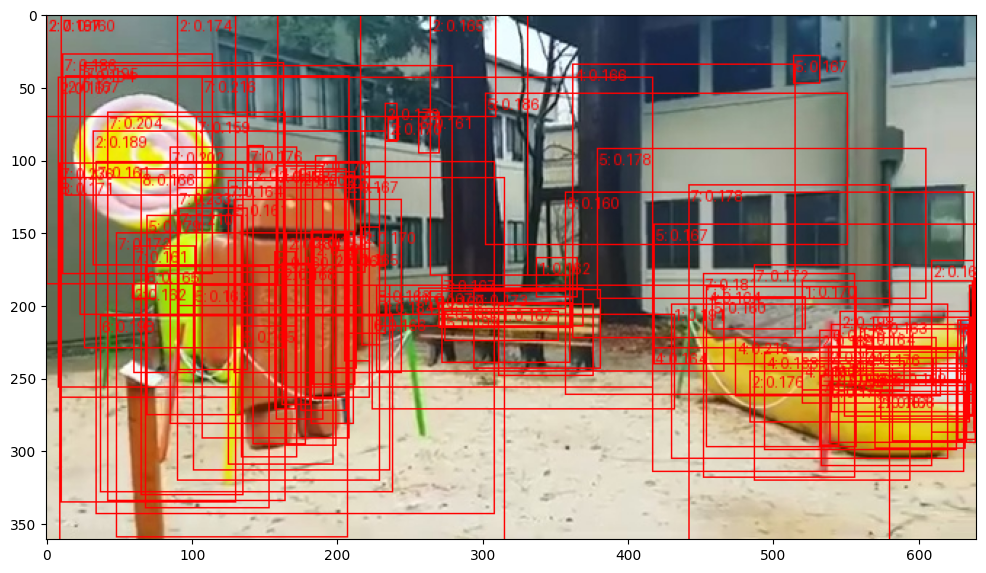

labels[4]=['1: 0.210', '2: 0.209', '2: 0.207', '6: 0.199', '2: 0.193', '2: 0.190', '2: 0.190', '2: 0.188', '2: 0.188', '5: 0.187', '2: 0.187', '2: 0.186', '4: 0.186', '8: 0.185', '5: 0.185', '8: 0.184', '2: 0.183', '4: 0.181', '2: 0.181', '4: 0.181', '7: 0.179', '2: 0.178', '5: 0.177', '5: 0.177', '2: 0.176', '2: 0.176', '5: 0.176', '5: 0.175', '2: 0.173', '2: 0.173', '5: 0.173', '5: 0.173', '2: 0.172', '7: 0.172', '2: 0.172', '6: 0.171', '2: 0.171', '5: 0.170', '7: 0.169', '3: 0.169', '4: 0.168', '5: 0.168', '1: 0.167', '2: 0.167', '2: 0.166', '5: 0.166', '5: 0.165', '5: 0.165', '2: 0.165', '7: 0.165', '2: 0.165', '2: 0.165', '2: 0.164', '2: 0.164', '4: 0.164', '1: 0.164', '2: 0.163', '2: 0.163', '2: 0.163', '6: 0.163', '8: 0.162', '6: 0.162', '2: 0.162', '2: 0.162', '5: 0.161', '2: 0.161', '6: 0.160', '6: 0.160', '7: 0.160', '2: 0.160', '2: 0.160', '8: 0.159', '2: 0.159', '2: 0.159', '5: 0.159', '6: 0.159', '2: 0.158', '5: 0.158', '1: 0.158', '2: 0.158', '5: 0.158', '7: 0.158', '2: 0

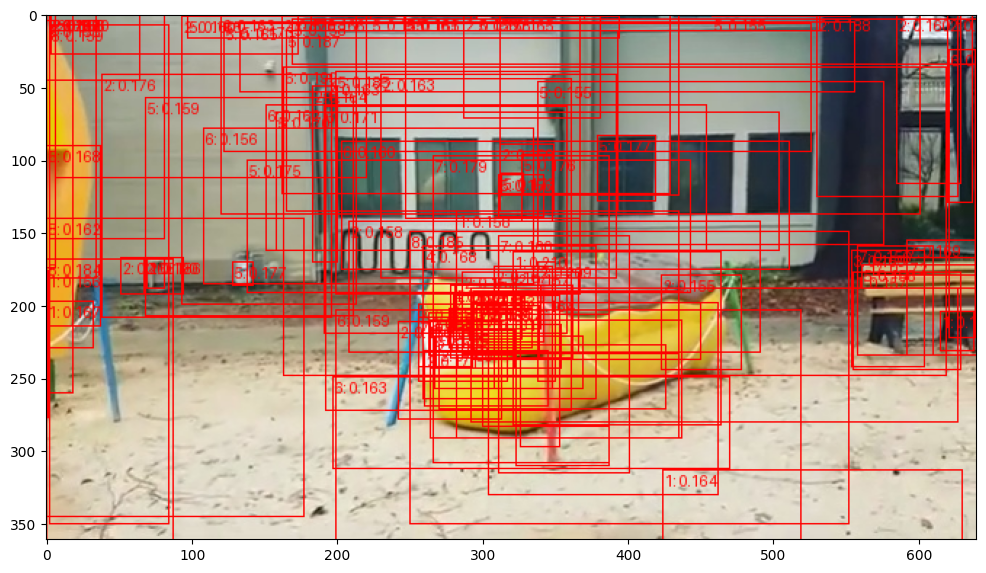

labels[5]=['7: 0.255', '7: 0.237', '2: 0.225', '7: 0.207', '4: 0.206', '6: 0.205', '2: 0.203', '2: 0.203', '5: 0.197', '7: 0.196', '7: 0.195', '5: 0.194', '2: 0.193', '2: 0.191', '2: 0.189', '7: 0.188', '7: 0.188', '7: 0.187', '2: 0.186', '7: 0.186', '2: 0.186', '7: 0.184', '5: 0.184', '7: 0.184', '5: 0.183', '2: 0.183', '5: 0.182', '6: 0.182', '2: 0.181', '5: 0.181', '7: 0.181', '5: 0.181', '7: 0.180', '2: 0.180', '2: 0.180', '2: 0.180', '6: 0.177', '7: 0.177', '3: 0.176', '7: 0.175', '4: 0.175', '6: 0.175', '5: 0.174', '2: 0.174', '6: 0.173', '2: 0.173', '2: 0.173', '7: 0.173', '2: 0.173', '2: 0.172', '4: 0.172', '2: 0.171', '2: 0.171', '5: 0.171', '5: 0.171', '7: 0.171', '5: 0.171', '2: 0.169', '7: 0.169', '6: 0.169', '6: 0.169', '5: 0.169', '4: 0.169', '2: 0.168', '2: 0.168', '5: 0.168', '2: 0.168', '7: 0.168', '8: 0.167', '2: 0.167', '6: 0.167', '5: 0.166', '6: 0.166', '5: 0.166', '7: 0.166', '2: 0.165', '4: 0.165', '5: 0.165', '2: 0.165', '6: 0.164', '7: 0.163', '5: 0.163', '6: 0

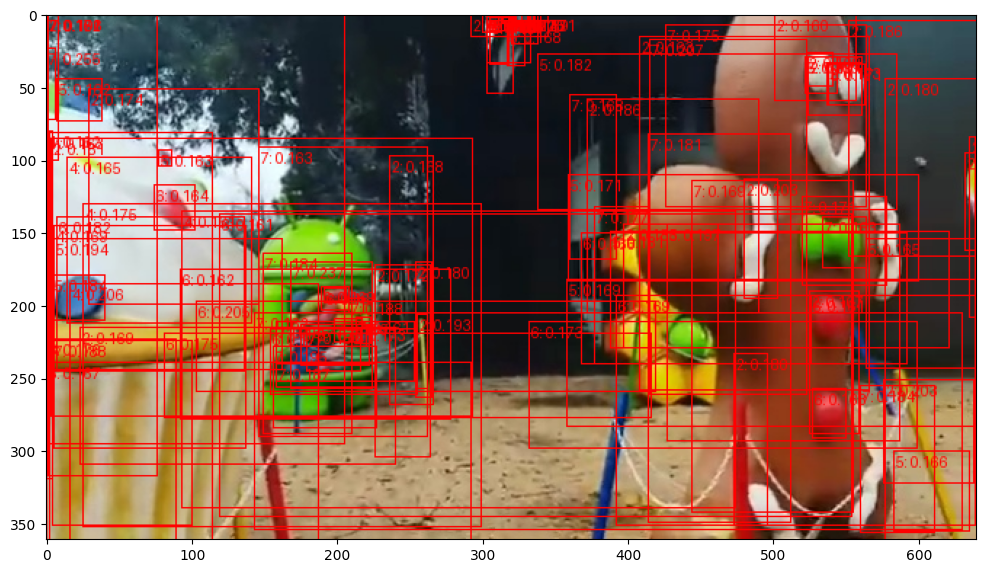

labels[6]=['2: 0.292', '2: 0.239', '5: 0.235', '2: 0.228', '4: 0.226', '5: 0.223', '2: 0.217', '2: 0.216', '2: 0.216', '2: 0.213', '5: 0.210', '2: 0.207', '5: 0.207', '5: 0.201', '2: 0.200', '2: 0.200', '5: 0.198', '2: 0.194', '2: 0.193', '2: 0.190', '7: 0.188', '5: 0.186', '5: 0.182', '2: 0.182', '4: 0.181', '5: 0.180', '6: 0.179', '2: 0.179', '2: 0.179', '1: 0.179', '2: 0.179', '2: 0.178', '2: 0.178', '2: 0.177', '5: 0.177', '2: 0.177', '2: 0.177', '2: 0.175', '2: 0.175', '8: 0.173', '5: 0.173', '2: 0.172', '7: 0.172', '5: 0.171', '5: 0.171', '6: 0.170', '2: 0.170', '2: 0.170', '8: 0.170', '2: 0.170', '1: 0.169', '7: 0.169', '2: 0.168', '2: 0.168', '7: 0.168', '5: 0.168', '2: 0.167', '5: 0.167', '5: 0.167', '2: 0.166', '5: 0.166', '5: 0.166', '2: 0.166', '5: 0.165', '5: 0.165', '6: 0.165', '2: 0.165', '7: 0.165', '1: 0.164', '5: 0.164', '2: 0.164', '2: 0.164', '5: 0.164', '2: 0.163', '2: 0.163', '3: 0.162', '5: 0.162', '6: 0.162', '1: 0.161', '8: 0.161', '2: 0.160', '5: 0.160', '2: 0

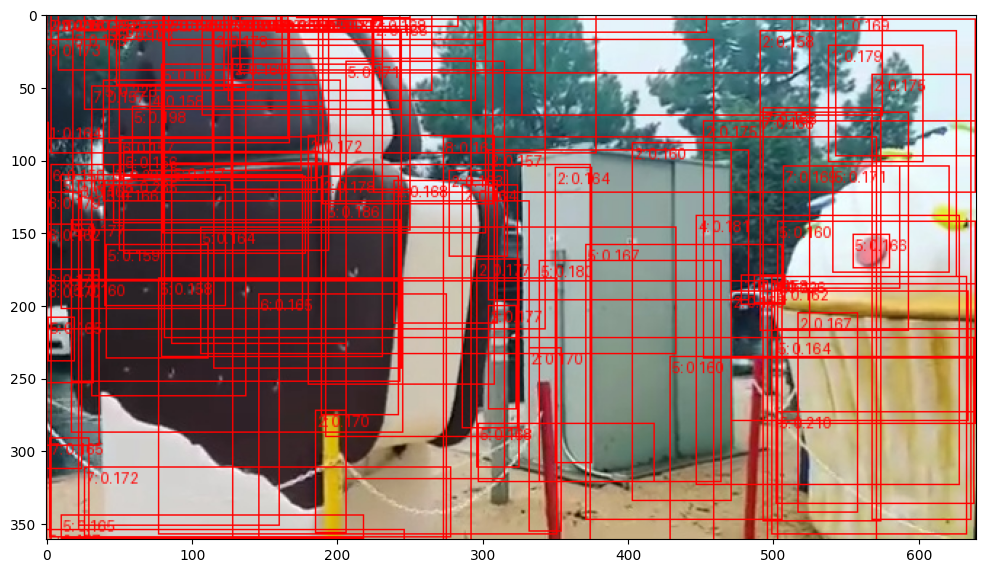

labels[7]=['7: 0.378', '2: 0.283', '7: 0.267', '7: 0.267', '2: 0.266', '7: 0.250', '6: 0.246', '7: 0.246', '7: 0.231', '2: 0.230', '2: 0.225', '7: 0.224', '2: 0.223', '4: 0.214', '7: 0.212', '2: 0.211', '7: 0.207', '7: 0.202', '5: 0.198', '7: 0.196', '8: 0.196', '5: 0.194', '2: 0.189', '4: 0.188', '5: 0.188', '7: 0.187', '8: 0.187', '2: 0.187', '7: 0.186', '5: 0.186', '2: 0.185', '7: 0.184', '7: 0.184', '7: 0.182', '6: 0.181', '2: 0.181', '7: 0.180', '7: 0.180', '4: 0.179', '4: 0.179', '5: 0.177', '6: 0.177', '8: 0.177', '2: 0.176', '2: 0.176', '7: 0.176', '2: 0.175', '2: 0.175', '2: 0.175', '6: 0.174', '6: 0.174', '7: 0.172', '6: 0.172', '7: 0.172', '5: 0.172', '5: 0.171', '7: 0.171', '7: 0.171', '7: 0.170', '7: 0.170', '5: 0.168', '1: 0.168', '4: 0.167', '5: 0.167', '2: 0.167', '2: 0.167', '2: 0.167', '4: 0.166', '7: 0.166', '1: 0.165', '8: 0.165', '4: 0.165', '2: 0.165', '7: 0.164', '1: 0.164', '2: 0.164', '6: 0.164', '4: 0.164', '4: 0.163', '5: 0.163', '2: 0.163', '4: 0.162', '1: 0

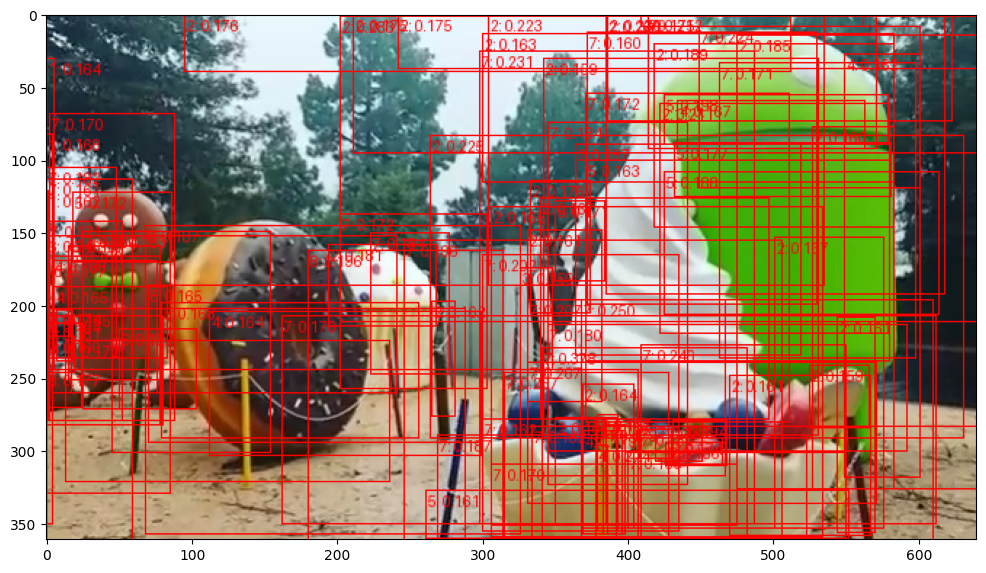

labels[8]=['2: 0.227', '7: 0.223', '4: 0.222', '2: 0.213', '2: 0.208', '2: 0.203', '5: 0.193', '5: 0.191', '7: 0.191', '2: 0.190', '6: 0.186', '4: 0.186', '4: 0.186', '8: 0.185', '7: 0.185', '5: 0.184', '5: 0.184', '7: 0.183', '5: 0.182', '2: 0.182', '8: 0.182', '2: 0.181', '5: 0.181', '5: 0.181', '6: 0.180', '4: 0.180', '7: 0.179', '5: 0.177', '7: 0.176', '5: 0.176', '7: 0.176', '6: 0.175', '2: 0.175', '7: 0.174', '4: 0.174', '2: 0.174', '2: 0.173', '8: 0.173', '6: 0.173', '2: 0.172', '2: 0.172', '5: 0.172', '2: 0.171', '2: 0.171', '7: 0.171', '5: 0.171', '2: 0.171', '4: 0.171', '2: 0.170', '8: 0.169', '2: 0.169', '7: 0.167', '6: 0.167', '4: 0.167', '2: 0.166', '1: 0.166', '5: 0.166', '1: 0.166', '2: 0.166', '5: 0.165', '5: 0.165', '6: 0.165', '2: 0.165', '2: 0.165', '6: 0.165', '7: 0.165', '4: 0.164', '7: 0.164', '2: 0.163', '6: 0.162', '5: 0.162', '7: 0.162', '5: 0.161', '5: 0.161', '2: 0.161', '2: 0.161', '6: 0.161', '2: 0.161', '7: 0.161', '5: 0.161', '5: 0.160', '8: 0.160', '6: 0

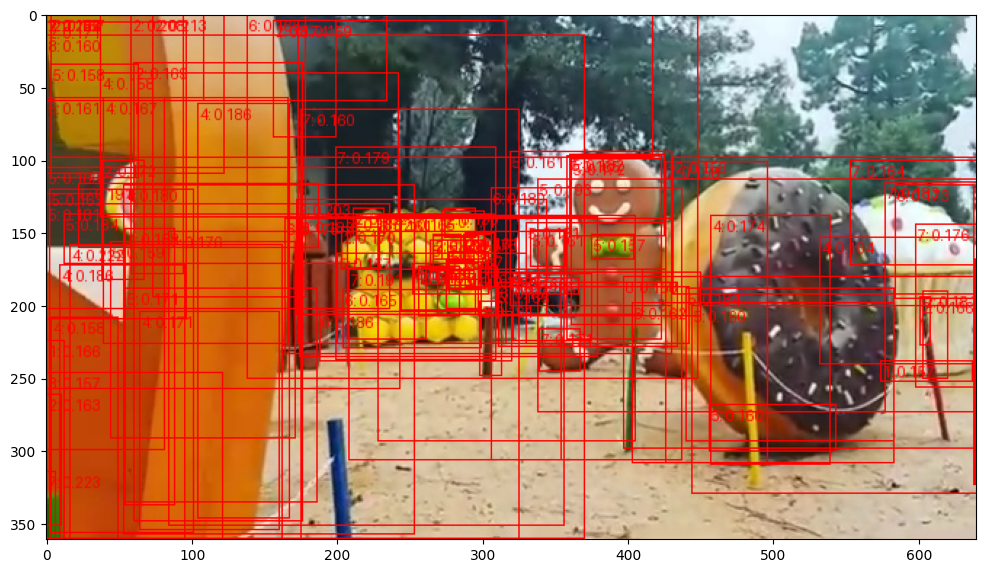

labels[9]=['5: 0.230', '5: 0.228', '4: 0.225', '4: 0.220', '7: 0.219', '7: 0.217', '7: 0.214', '4: 0.208', '2: 0.205', '5: 0.201', '2: 0.200', '5: 0.197', '7: 0.194', '5: 0.194', '4: 0.194', '7: 0.193', '5: 0.193', '8: 0.193', '5: 0.192', '2: 0.188', '2: 0.188', '1: 0.188', '2: 0.188', '4: 0.187', '4: 0.187', '4: 0.186', '4: 0.185', '4: 0.185', '4: 0.184', '2: 0.184', '7: 0.183', '4: 0.183', '7: 0.182', '8: 0.181', '4: 0.181', '4: 0.180', '7: 0.180', '5: 0.180', '4: 0.180', '2: 0.179', '5: 0.179', '2: 0.179', '2: 0.178', '5: 0.178', '6: 0.178', '5: 0.177', '6: 0.177', '2: 0.177', '4: 0.176', '1: 0.175', '5: 0.175', '4: 0.175', '7: 0.175', '7: 0.174', '4: 0.174', '5: 0.173', '7: 0.172', '2: 0.171', '2: 0.171', '5: 0.171', '6: 0.171', '5: 0.170', '6: 0.170', '4: 0.170', '7: 0.170', '2: 0.169', '4: 0.169', '2: 0.169', '6: 0.169', '2: 0.169', '4: 0.169', '6: 0.169', '2: 0.168', '5: 0.168', '6: 0.168', '2: 0.167', '5: 0.167', '7: 0.167', '7: 0.167', '5: 0.166', '2: 0.166', '1: 0.166', '5: 0

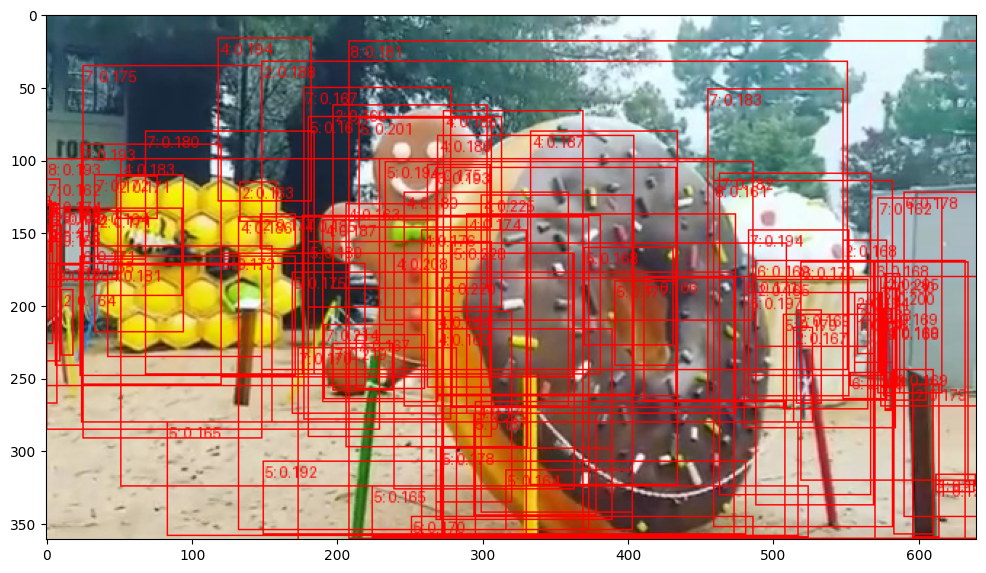

labels[10]=['2: 0.256', '2: 0.250', '5: 0.242', '6: 0.236', '7: 0.235', '2: 0.222', '7: 0.215', '2: 0.214', '2: 0.211', '5: 0.210', '6: 0.208', '7: 0.207', '2: 0.207', '5: 0.204', '2: 0.202', '2: 0.199', '1: 0.199', '2: 0.198', '7: 0.198', '2: 0.198', '7: 0.197', '2: 0.195', '6: 0.192', '7: 0.192', '7: 0.192', '6: 0.192', '8: 0.189', '2: 0.188', '4: 0.188', '4: 0.187', '2: 0.187', '7: 0.187', '7: 0.187', '2: 0.186', '7: 0.185', '7: 0.184', '6: 0.184', '2: 0.183', '4: 0.182', '2: 0.181', '5: 0.180', '2: 0.179', '2: 0.178', '2: 0.178', '5: 0.178', '7: 0.177', '2: 0.177', '5: 0.177', '7: 0.177', '7: 0.177', '6: 0.176', '2: 0.176', '7: 0.175', '2: 0.175', '7: 0.175', '5: 0.175', '8: 0.174', '2: 0.174', '2: 0.173', '7: 0.172', '2: 0.172', '5: 0.172', '4: 0.171', '2: 0.169', '2: 0.169', '2: 0.168', '5: 0.168', '1: 0.168', '5: 0.167', '2: 0.167', '2: 0.166', '1: 0.166', '5: 0.166', '5: 0.166', '7: 0.166', '2: 0.166', '5: 0.165', '6: 0.165', '2: 0.165', '2: 0.164', '6: 0.164', '7: 0.164', '2: 

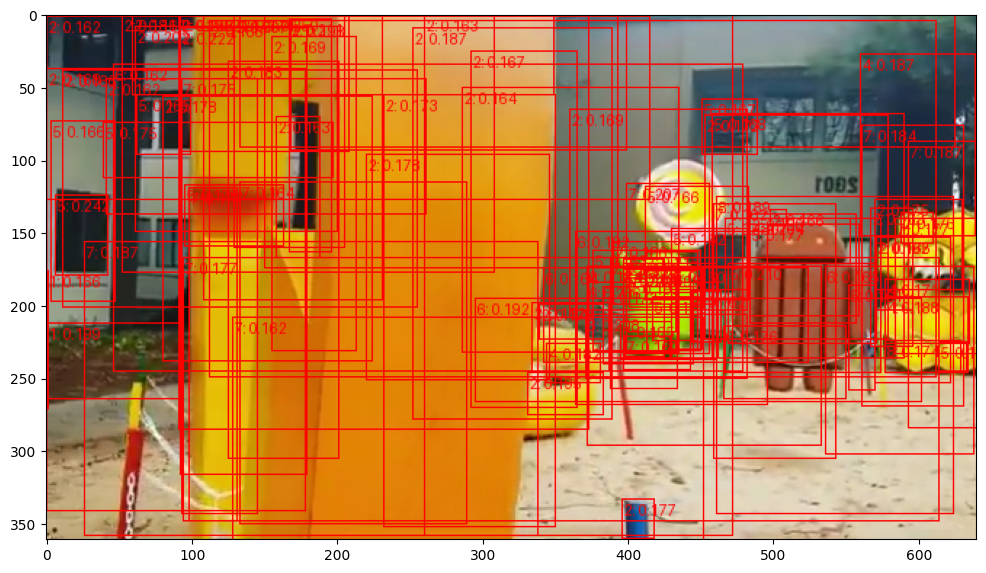

labels[11]=['7: 0.282', '2: 0.275', '5: 0.273', '7: 0.268', '7: 0.245', '7: 0.241', '7: 0.240', '2: 0.227', '7: 0.223', '2: 0.213', '2: 0.212', '2: 0.209', '6: 0.209', '7: 0.208', '7: 0.207', '4: 0.206', '7: 0.205', '6: 0.205', '6: 0.199', '7: 0.196', '2: 0.195', '2: 0.195', '7: 0.190', '2: 0.189', '7: 0.189', '7: 0.188', '2: 0.186', '2: 0.185', '2: 0.184', '2: 0.184', '5: 0.184', '5: 0.183', '6: 0.182', '6: 0.182', '2: 0.181', '7: 0.180', '2: 0.177', '2: 0.177', '7: 0.177', '5: 0.175', '7: 0.175', '2: 0.175', '8: 0.175', '6: 0.174', '6: 0.174', '7: 0.174', '2: 0.174', '8: 0.173', '2: 0.173', '2: 0.173', '5: 0.173', '5: 0.173', '5: 0.172', '5: 0.172', '5: 0.172', '8: 0.172', '2: 0.171', '6: 0.171', '7: 0.171', '5: 0.170', '2: 0.170', '2: 0.169', '8: 0.169', '2: 0.169', '2: 0.168', '7: 0.168', '2: 0.168', '4: 0.168', '2: 0.168', '2: 0.167', '2: 0.167', '2: 0.166', '8: 0.166', '2: 0.165', '2: 0.165', '5: 0.165', '2: 0.164', '7: 0.164', '5: 0.164', '7: 0.164', '2: 0.163', '7: 0.163', '2: 

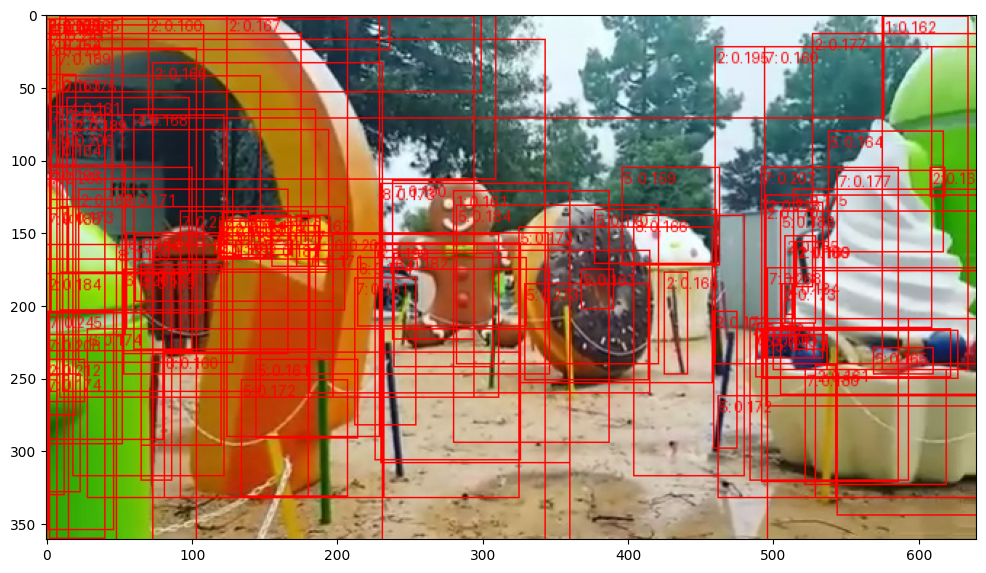

labels[12]=['2: 0.277', '7: 0.264', '7: 0.239', '2: 0.238', '2: 0.233', '2: 0.228', '7: 0.219', '2: 0.215', '2: 0.214', '2: 0.213', '2: 0.212', '7: 0.212', '5: 0.210', '7: 0.209', '6: 0.205', '7: 0.204', '2: 0.203', '6: 0.201', '2: 0.198', '4: 0.198', '7: 0.197', '2: 0.195', '5: 0.194', '2: 0.193', '2: 0.192', '2: 0.191', '2: 0.191', '5: 0.190', '2: 0.189', '7: 0.189', '2: 0.188', '7: 0.188', '5: 0.187', '5: 0.186', '5: 0.186', '7: 0.184', '2: 0.183', '6: 0.180', '8: 0.180', '5: 0.179', '3: 0.179', '7: 0.179', '5: 0.179', '1: 0.178', '2: 0.178', '2: 0.178', '7: 0.177', '7: 0.177', '6: 0.177', '5: 0.177', '6: 0.176', '7: 0.176', '3: 0.176', '6: 0.175', '2: 0.174', '5: 0.174', '2: 0.173', '2: 0.172', '5: 0.172', '7: 0.171', '2: 0.170', '5: 0.170', '3: 0.170', '8: 0.170', '2: 0.170', '6: 0.169', '6: 0.169', '2: 0.169', '2: 0.168', '2: 0.168', '2: 0.168', '2: 0.167', '8: 0.167', '5: 0.167', '5: 0.167', '3: 0.166', '2: 0.166', '2: 0.165', '1: 0.165', '7: 0.165', '2: 0.165', '2: 0.165', '2: 

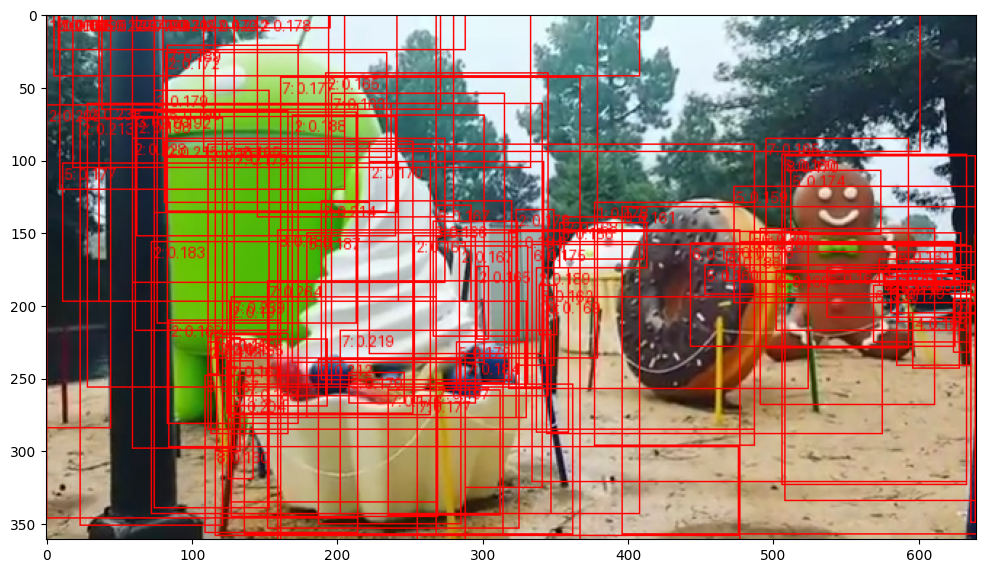

labels[13]=['2: 0.261', '7: 0.249', '2: 0.247', '7: 0.217', '7: 0.213', '2: 0.212', '5: 0.212', '2: 0.210', '2: 0.209', '2: 0.205', '4: 0.199', '5: 0.198', '7: 0.197', '7: 0.196', '2: 0.195', '2: 0.195', '2: 0.191', '5: 0.191', '2: 0.190', '3: 0.189', '4: 0.188', '4: 0.188', '2: 0.188', '5: 0.186', '7: 0.186', '6: 0.186', '2: 0.186', '2: 0.185', '6: 0.185', '6: 0.184', '6: 0.183', '5: 0.181', '2: 0.180', '2: 0.179', '2: 0.179', '2: 0.179', '5: 0.178', '3: 0.177', '7: 0.177', '5: 0.177', '2: 0.177', '7: 0.176', '2: 0.176', '2: 0.175', '2: 0.175', '6: 0.175', '7: 0.174', '8: 0.174', '6: 0.173', '8: 0.173', '2: 0.173', '5: 0.172', '2: 0.172', '4: 0.171', '2: 0.171', '2: 0.170', '5: 0.170', '5: 0.169', '2: 0.168', '4: 0.168', '5: 0.168', '2: 0.168', '2: 0.166', '7: 0.166', '5: 0.166', '6: 0.166', '2: 0.166', '5: 0.166', '7: 0.165', '5: 0.165', '7: 0.165', '5: 0.165', '7: 0.164', '2: 0.164', '5: 0.164', '5: 0.164', '6: 0.163', '2: 0.163', '5: 0.162', '2: 0.162', '7: 0.162', '2: 0.162', '5: 

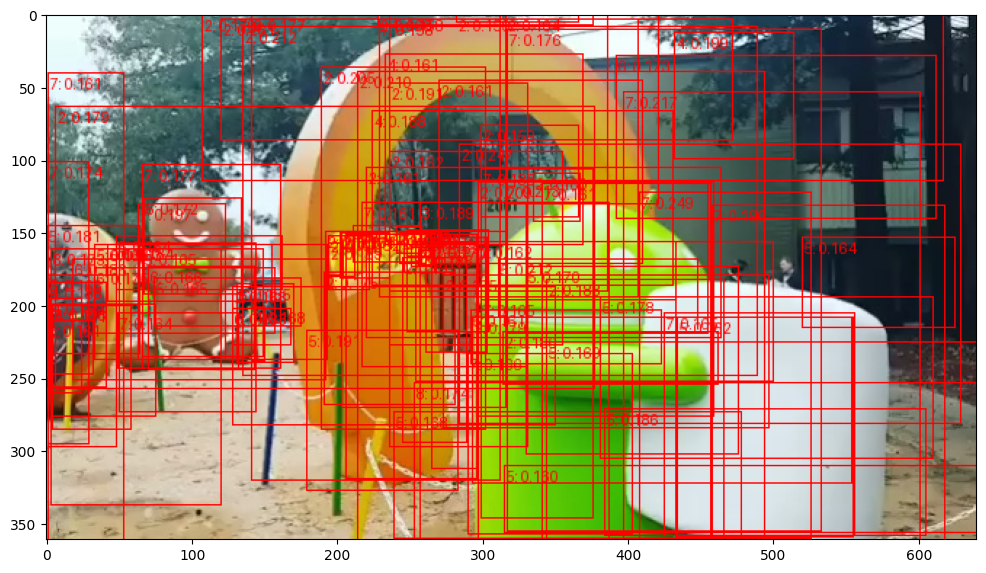

begin fine-tuning
Epoch: 0, Loss: 2.9436888694763184
Epoch: 0, Loss: 2.1389870643615723
Epoch: 0, Loss: 2.0320374965667725
Epoch: 0, Loss: 1.5011403560638428
Epoch: 0, Loss: 1.0607112646102905
Epoch: 0, Loss: 0.9113039970397949
Epoch: 0, Loss: 0.5708783864974976
Epoch: 1, Loss: 1.6081277132034302
Epoch: 1, Loss: 1.0166645050048828
Epoch: 1, Loss: 1.3982881307601929
Epoch: 1, Loss: 0.9384189248085022
Epoch: 1, Loss: 0.4771583676338196
Epoch: 1, Loss: 0.6519956588745117
Epoch: 1, Loss: 0.3755408227443695
Epoch: 2, Loss: 1.5361911058425903
Epoch: 2, Loss: 0.8833608031272888
Epoch: 2, Loss: 1.2787655591964722
Epoch: 2, Loss: 0.7914491891860962
Epoch: 2, Loss: 0.4211530387401581
Epoch: 2, Loss: 0.5926632881164551
Epoch: 2, Loss: 0.3299388885498047
Epoch: 3, Loss: 1.3587086200714111
Epoch: 3, Loss: 0.7372464537620544
Epoch: 3, Loss: 1.1782528162002563
Epoch: 3, Loss: 0.6630936861038208
Epoch: 3, Loss: 0.4649127423763275
Epoch: 3, Loss: 0.593376100063324
Epoch: 3, Loss: 0.4165867865085602
eva

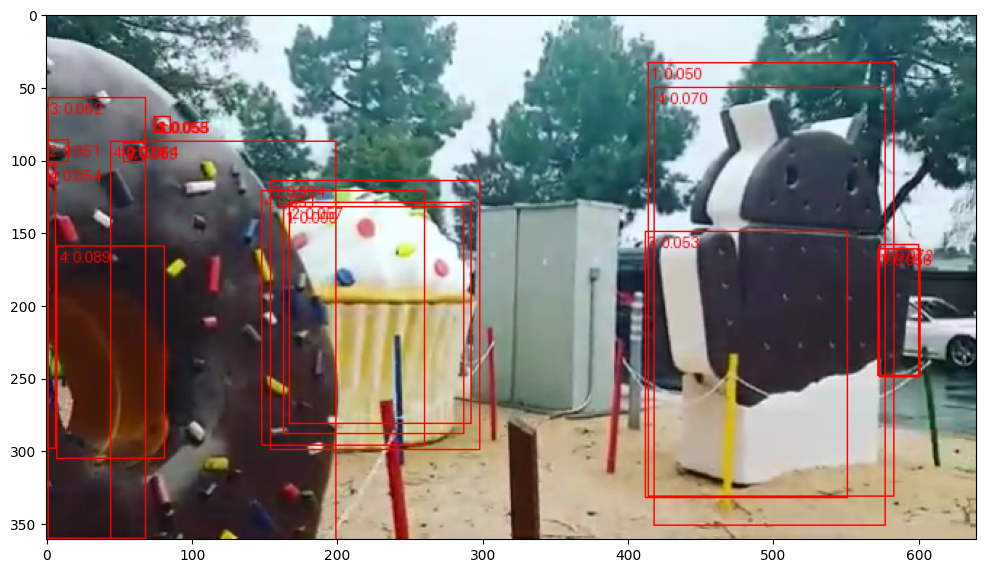

labels[1]=['4: 0.106', '1: 0.093', '4: 0.091', '4: 0.083', '2: 0.070', '3: 0.068', '4: 0.066', '4: 0.062', '4: 0.059', '2: 0.058', '6: 0.053']


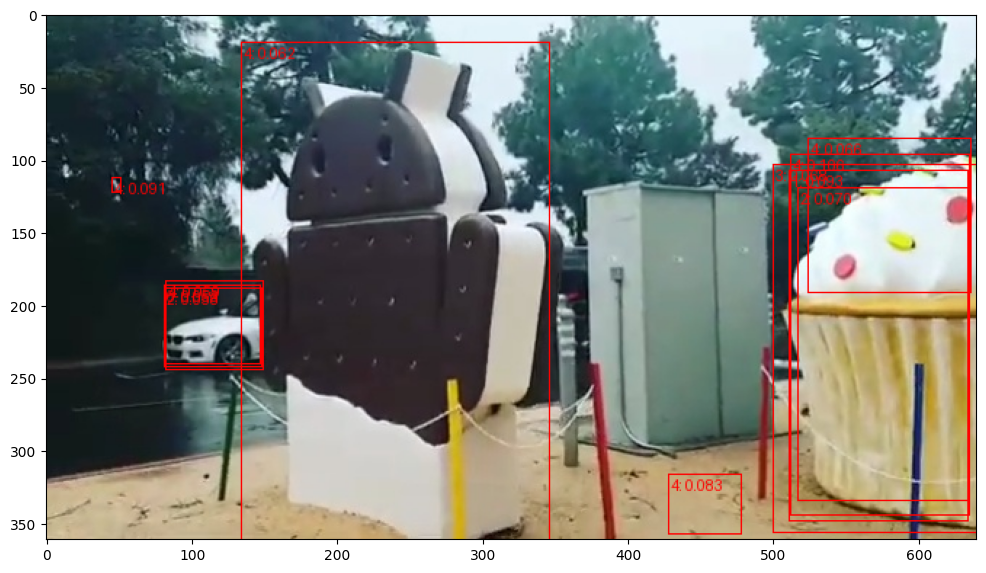

labels[2]=['4: 0.204', '2: 0.106', '4: 0.089', '1: 0.072', '4: 0.064', '2: 0.058', '3: 0.058', '3: 0.057', '5: 0.056']


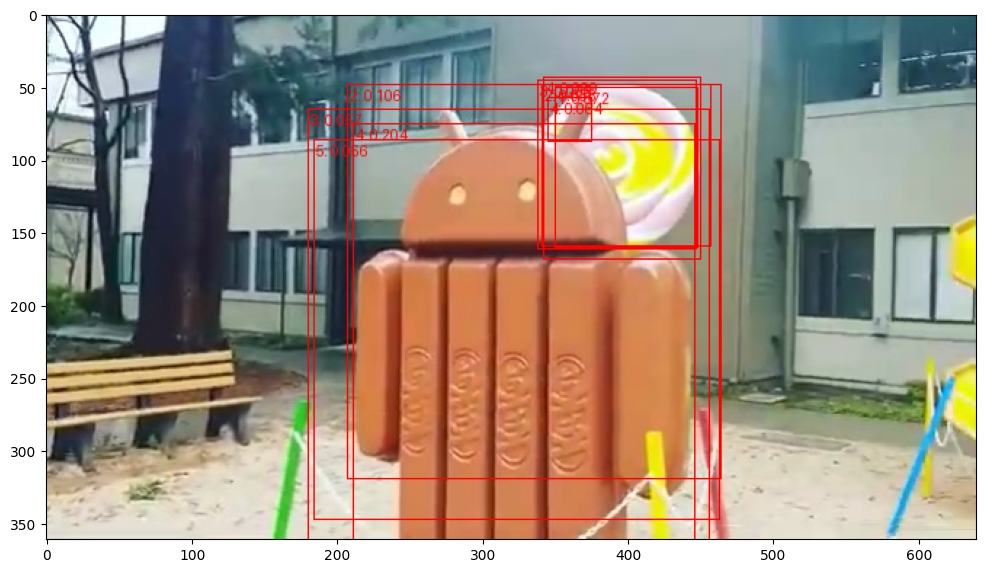

labels[3]=['2: 0.118', '4: 0.094', '4: 0.071', '4: 0.070', '2: 0.064', '3: 0.057', '2: 0.056', '3: 0.054', '4: 0.054', '1: 0.053', '4: 0.053', '1: 0.053', '1: 0.053', '1: 0.051', '1: 0.051']


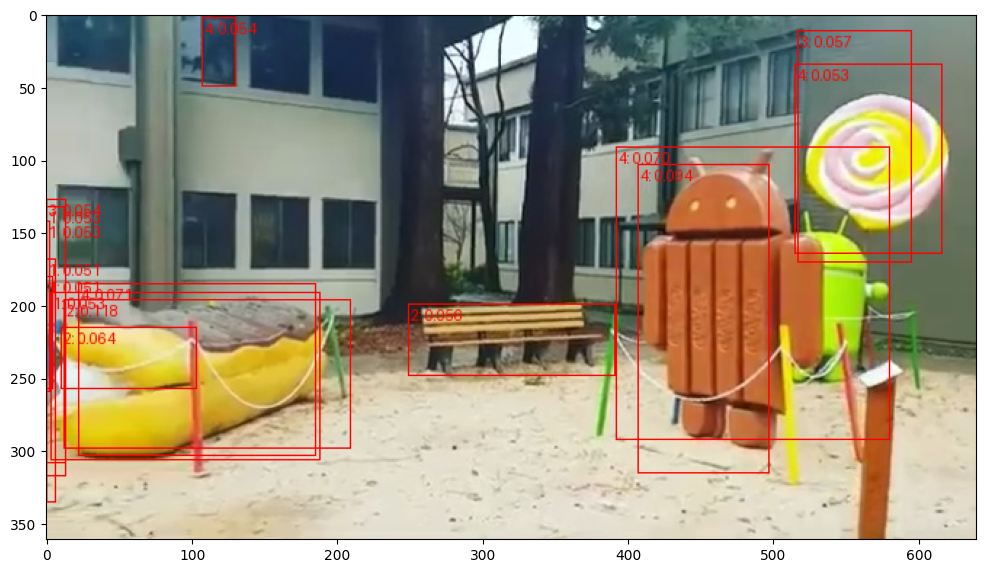

labels[4]=['4: 0.120', '2: 0.112', '2: 0.078', '4: 0.069', '4: 0.065', '1: 0.065', '4: 0.063', '1: 0.060', '4: 0.059', '4: 0.055', '2: 0.054', '2: 0.053', '2: 0.052', '1: 0.051', '2: 0.050']


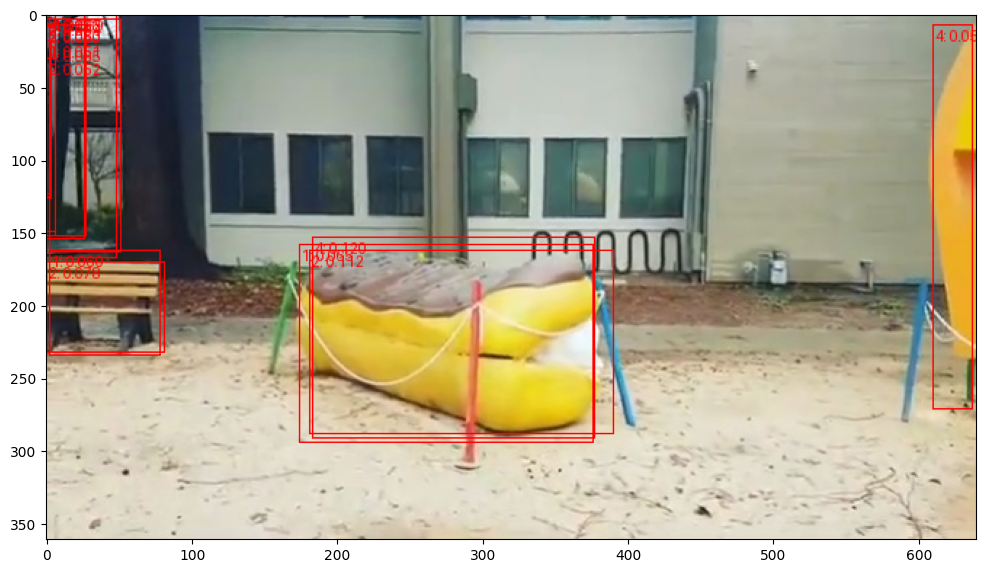

labels[5]=['4: 0.162', '4: 0.136', '4: 0.102', '3: 0.098', '2: 0.098', '4: 0.094', '4: 0.071', '4: 0.071', '4: 0.064', '6: 0.062', '3: 0.058', '2: 0.057', '3: 0.056', '2: 0.055', '4: 0.055', '3: 0.053', '4: 0.052', '2: 0.052']


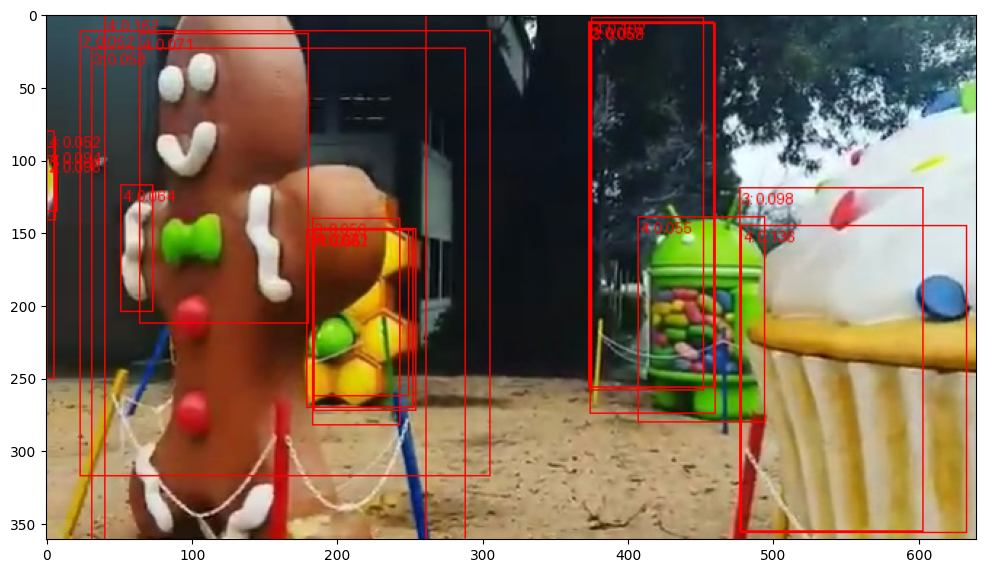

labels[6]=['3: 0.103', '4: 0.077', '4: 0.070', '3: 0.061', '2: 0.058', '4: 0.057', '1: 0.056']


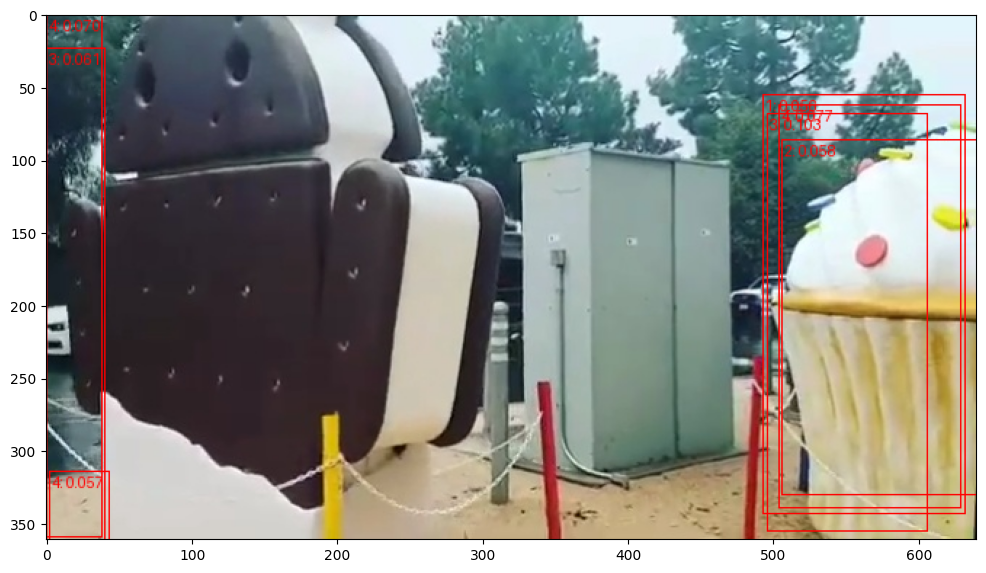

labels[7]=['4: 0.161', '4: 0.079', '3: 0.076', '4: 0.071', '4: 0.070', '4: 0.056', '4: 0.053', '3: 0.053']


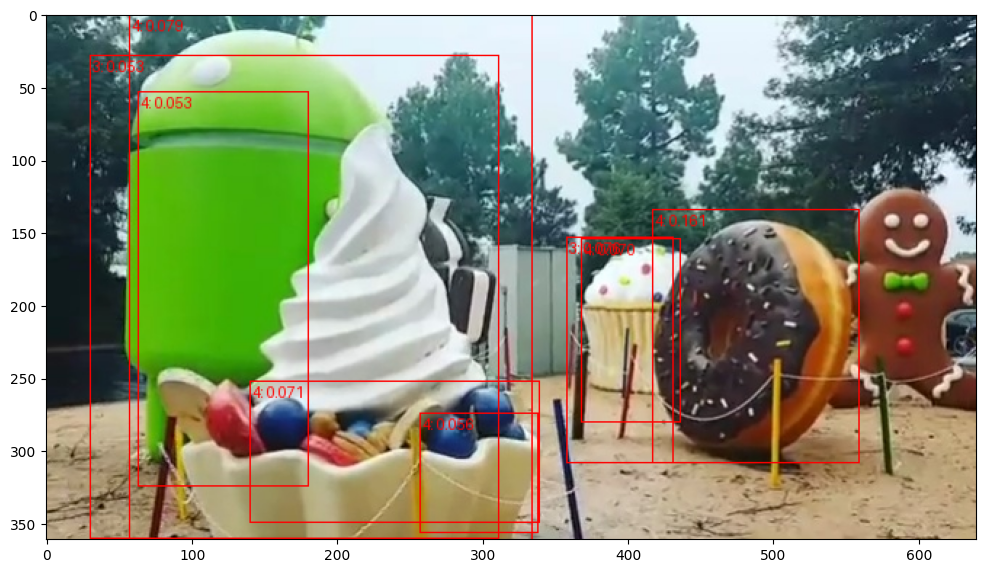

labels[8]=['4: 0.133', '4: 0.109', '6: 0.087', '4: 0.083', '4: 0.075', '4: 0.074', '4: 0.073', '4: 0.068', '3: 0.068', '2: 0.068', '2: 0.065', '4: 0.065', '4: 0.059', '2: 0.054', '2: 0.052']


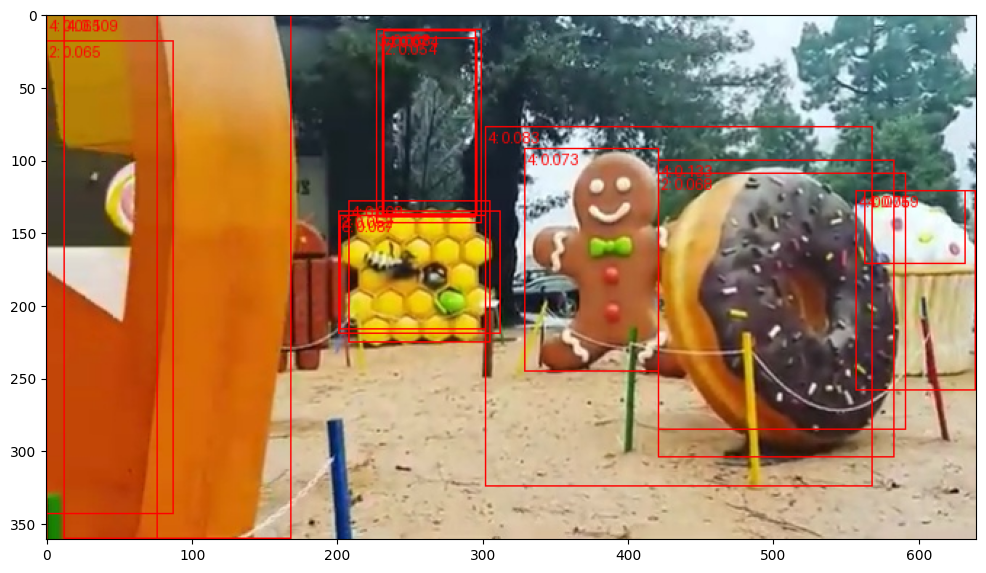

labels[9]=['4: 0.134', '4: 0.088', '4: 0.078', '3: 0.073', '4: 0.068', '6: 0.067', '3: 0.056', '4: 0.054', '2: 0.054', '2: 0.050']


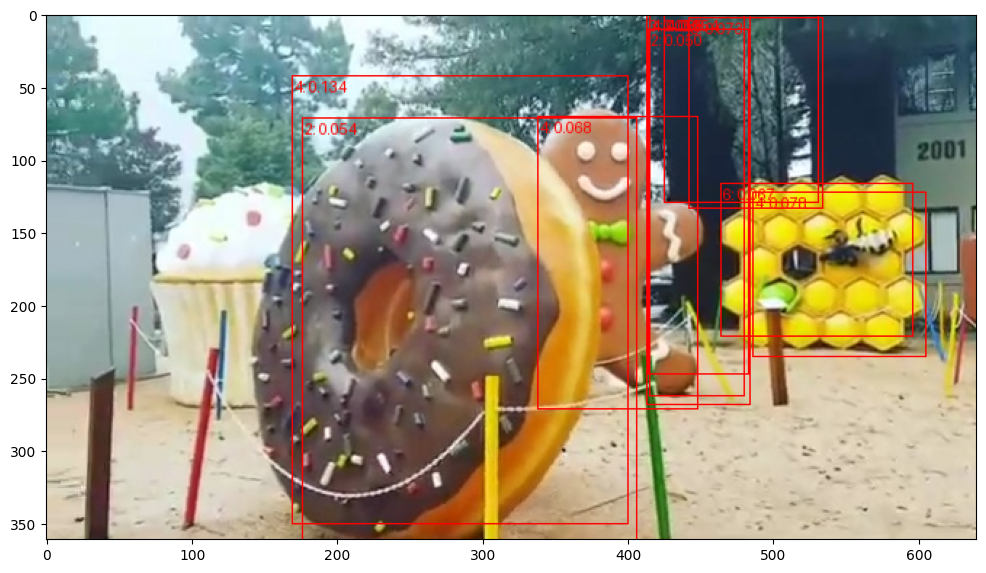

labels[10]=['6: 0.082', '3: 0.078', '4: 0.077', '3: 0.065', '2: 0.064', '4: 0.062', '4: 0.055', '4: 0.055', '1: 0.054', '4: 0.054', '4: 0.054', '4: 0.054', '4: 0.052', '4: 0.052']


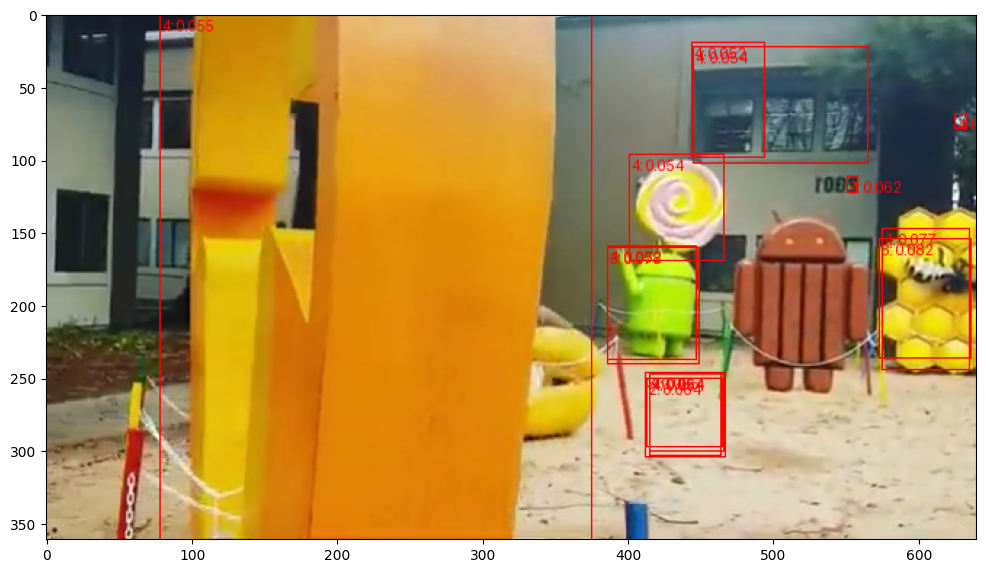

labels[11]=['4: 0.201', '3: 0.108', '4: 0.105', '4: 0.091', '4: 0.071', '4: 0.061', '2: 0.055', '4: 0.054', '4: 0.054', '2: 0.053', '3: 0.052', '2: 0.052', '1: 0.050']


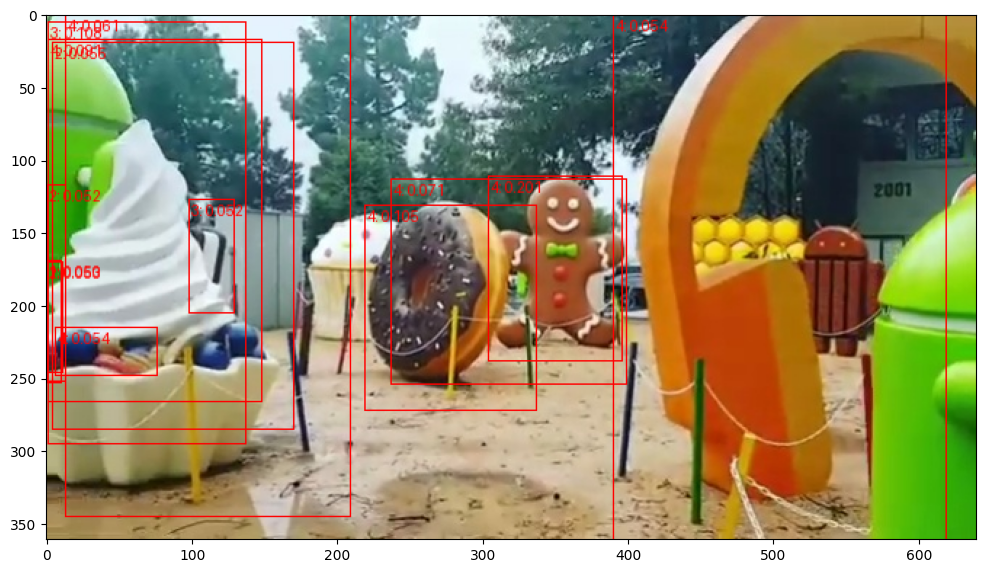

labels[12]=['4: 0.116', '4: 0.112', '4: 0.085', '2: 0.075', '4: 0.074', '3: 0.064', '4: 0.059', '4: 0.057', '4: 0.054', '1: 0.052']


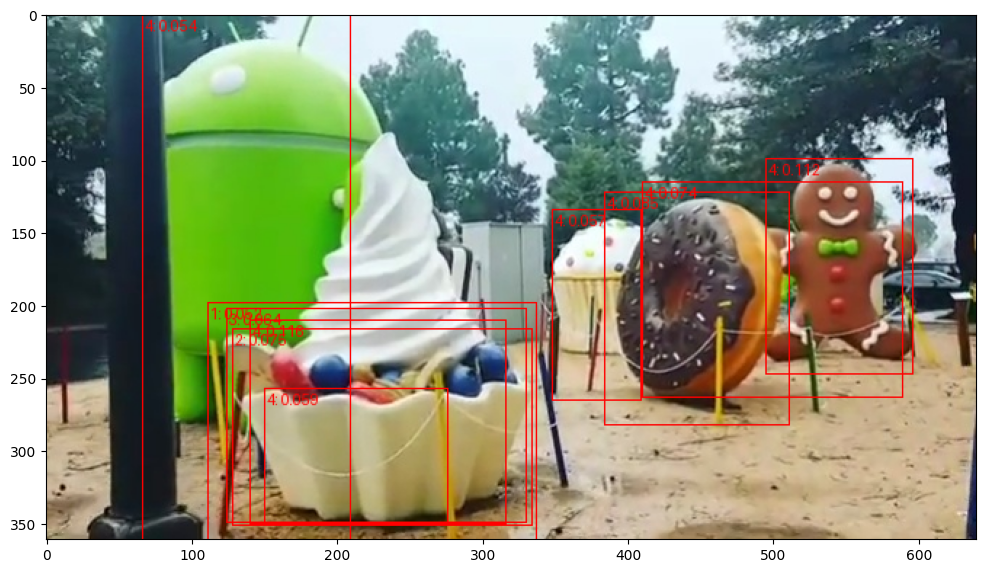

labels[13]=['4: 0.258', '4: 0.165', '4: 0.134', '2: 0.076', '1: 0.059', '4: 0.059', '4: 0.058', '2: 0.056', '1: 0.054', '3: 0.052']


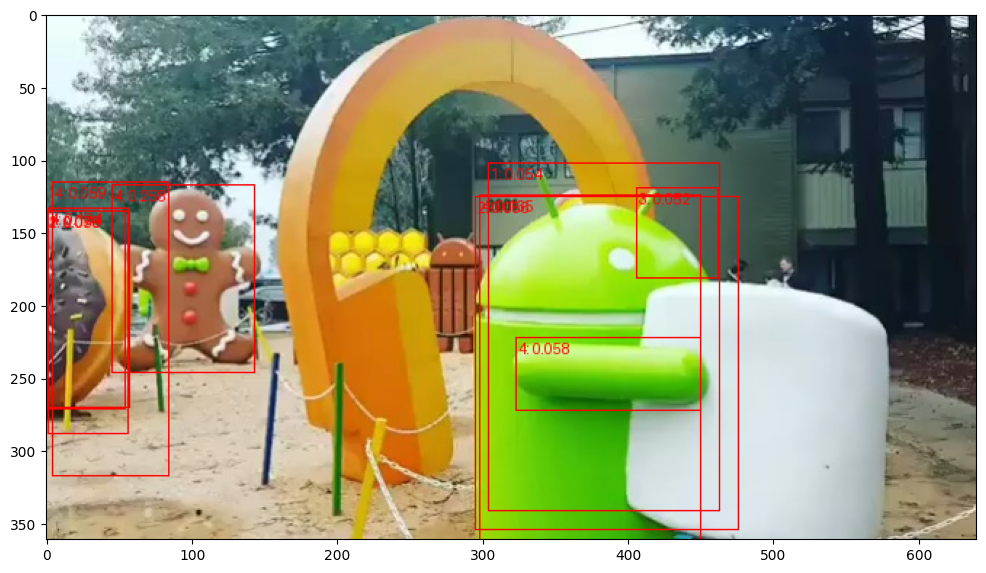

In [6]:
transforms = load_pytorch_models.get_transform(train=True)

# check test results w/o training
%matplotlib inline
print('run pre-trained model on test data')
model.eval()
with torch.no_grad():
    j = 0
    for filepath in filepaths:
        image = tv_tensors.Image(read_image(filepath))
        image = transforms(image)
        images = [image.to(device)]
        # Forward pass
        prediction = model(images)
        for img in images:
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            pred_labels = [f"{label}: {score:.3f}" for label, score in zip(prediction[0]["labels"], prediction[0]["scores"])]
            pred_boxes = prediction[0]["boxes"].long()
            output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            print(f'labels[{j}]={pred_labels}')
            plt.show()
        j+=1

print('begin fine-tuning')

learning_rate = 0.001
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=learning_rate)

epochs = 4

model.train()
for epoch in range(epochs):
    for images, targets in data_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
    
        # Forward pass
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        
        # Zero the gradients
        optimizer.zero_grad()

        # Backward pass
        losses.backward()

        # Update model parameters
        optimizer.step()

        # Print or log training progress
        print(f"Epoch: {epoch}, Loss: {losses.item()}")

print('evalulate fine-tuned model on test data')

model.eval()
with torch.no_grad():
    j = 0
    for filepath in filepaths:
        image = tv_tensors.Image(read_image(filepath))
        image = transforms(image)
        images = [image.to(device)]
        # Forward pass
        prediction = model(images)
        for img in images:
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            pred_labels = [f"{label}: {score:.3f}" for label, score in zip(prediction[0]["labels"], prediction[0]["scores"])]
            pred_boxes = prediction[0]["boxes"].long()
            output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            print(f'labels[{j}]={pred_labels}')
            plt.show()
        j+=1

